In [1]:
import pandas as pd
import numpy as np
from pathlib import Path
import panel as pn
from panel.interact import interact
import plotly.express as px
pn.extension("plotly")
from plotly import graph_objects as go
from plotly.subplots import make_subplots
from plotly.offline import plot
from panel.interact import interact 
from panel import widgets
import os

In [2]:
import hvplot.pandas

In [19]:
div_mt_returns = pd.read_csv(Path("../Resources/div_mt_returns.csv"))
div_actual_returns = pd.read_csv(Path("../Resources/div_actual_returns.csv"))
div_simulated_ending = pd.read_csv(Path("../Resources/div_simulated_ending.csv"))
####
em_mt_returns = pd.read_csv(Path("../Resources/em_mt_returns.csv"))
em_actual_returns = pd.read_csv(Path("../Resources/em_actual_returns.csv"))
em_simulated_ending = pd.read_csv(Path("../Resources/em_simulated_ending.csv"))
####
tech_mt_returns = pd.read_csv(Path("../Resources/tech_monte_carlo.csv"), index_col=None)
tech_actual_returns = pd.read_csv(Path("../Resources/tech_actual_data.csv"))
tech_simulated_ending = pd.read_csv(Path("../Resources/tech_simulated_ending_prices.csv"))
####
pharma_mt_returns = pd.read_csv(Path("../Resources/pharma_monte_carlo.csv"))
pharma_actual_returns = pd.read_csv(Path("../Resources/pharma_actual_data.csv"))
pharma_simulated_ending = pd.read_csv(Path("../Resources/pharma_simulated_ending_prices.csv"))
####
travel_mt_returns = pd.read_csv(Path("../Resources/travel_monte_carlo.csv"))
travel_actual_returns = pd.read_csv(Path("../Resources/travel_actual_data.csv"))
travel_simulated_ending = pd.read_csv(Path("../Resources/travel_simulated_ending_prices.csv"))
####
currency_returns=pd.read_csv(Path('Actual_returns.csv'))
currency_confidence_interval_returns=pd.read_csv(Path('Confidence_Interval.csv'))
currency_simulated_returns = pd.read_csv(Path('Pre_Covid_Monte_Carlo.csv'))
simulated_ending_prices = currency_simulated_returns.iloc[-1, :]
####
brk_all_19 = pd.read_csv(Path("../Resources/BRK_all_2019.csv"))
brk_all_20 = pd.read_csv(Path("../Resources/BRK_all_2020.csv"))
####
brk_portfolio = pd.read_csv(Path("../Resources/brk_portfolio_return.csv"))
brk_actual = pd.read_csv(Path("../Resources/brk_real.csv"))

In [4]:
### MONTE CARLO vs ACTUAL
fig_div_mt = px.line(div_mt_returns,range_y=[0.5,1.5])
fig_div_actual = px.line(div_actual_returns,range_y=[0.5,1.5])
div = pn.Row(fig_div_mt,fig_div_actual)
####
fig_em_mt = px.line(em_mt_returns,range_y=[0.6,1.3])
fig_em_actual = px.line(em_actual_returns,range_y=[0.6,1.2])
em = pn.Row(fig_em_mt,fig_em_actual)
####
fig_tech_mt=px.line(tech_mt_returns, range_y=[.5,1.5] )
fig_tech_actual = px.line(tech_actual_returns, range_y=[.5,1.5] )
tech = pn.Row(fig_tech_mt,fig_tech_actual)
####
fig_pharma_mt=px.line(pharma_mt_returns, range_y=[.7,1.4])
fig_pharma_actual = px.line(pharma_actual_returns, range_y=[.7,1.4])
pharma = pn.Row(fig_pharma_mt,fig_pharma_actual)
####
fig_travel_mt=px.line(travel_mt_returns, range_y=[.3,1.5])
fig_travel_actual = px.line(travel_actual_returns, range_y=[.3,1.5])
travel = pn.Row(fig_travel_mt,fig_travel_actual)
####
currency_montecarlo_returns=px.line(currency_simulated_returns, range_y=[0.4,1.7])
fig_currency_actual=px.line(currency_returns, range_y=[0.4,1.7])
row = pn.Row(currency_montecarlo_returns,fig_currency_actual)

In [5]:
monte_carlo_vs_actual = pn.Tabs(("Technology",tech),("Travel",travel),("Pharma",pharma),("Dividend",div),("Emerging Markets",em),("Currency",row))

In [37]:
monte_carlo_vs_actual.servable()

Tabs
    [0] Row
        [0] Plotly(Figure, viewport={'xaxis.range': [0, ...})
        [1] Plotly(Figure, viewport={'xaxis.range': [0, ...})
    [1] Row
        [0] Plotly(Figure, viewport={'xaxis.range': [0, ...})
        [1] Plotly(Figure, viewport={'xaxis.range': [0, ...})
    [2] Row
        [0] Plotly(Figure, viewport={'xaxis.range': [0, ...})
        [1] Plotly(Figure, viewport={'xaxis.range': [0, ...})
    [3] Row
        [0] Plotly(Figure, viewport={'xaxis.range': [0, ...})
        [1] Plotly(Figure, viewport={'xaxis.range': [0, ...})
    [4] Row
        [0] Plotly(Figure, viewport={'xaxis.range': [0, ...})
        [1] Plotly(Figure, viewport={'xaxis.range': [0, ...})
    [5] Row
        [0] Plotly(Figure, hover_data={'points': [{'curveNumber'...}, viewport={'xaxis.range': [0, ...})
        [1] Plotly(Figure, viewport={'xaxis.range': [0, ...})

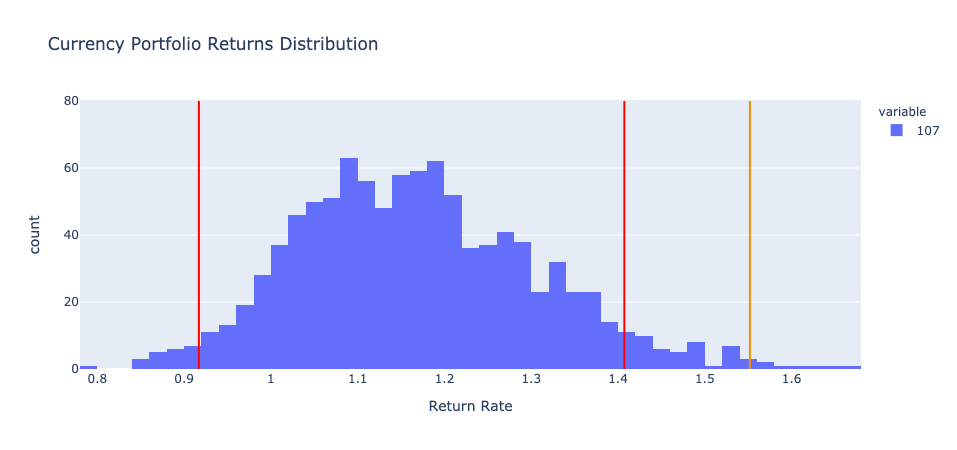

In [11]:
fig_div_dist = px.histogram(div_simulated_ending,nbins=50,labels={'value':'Return Rate'},title='Dividend Stocks Portfolio Returns Distribution',range_x=[0.8,1.25])
fig_div_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=0.87,y0=0,x1=0.87, y1=80,line=dict(color="DarkOrange")),
)
fig_div_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=0.908064,y0=0,x1=0.908064, y1=80,line=dict(color="Red")),
)
fig_div_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=1.171526,y0=0,x1=1.171526, y1=80,line=dict(color="Red")),
)
####
fig_em_dist = px.histogram(em_simulated_ending,nbins=50,labels={'value':'Return Rate'},title='Emerging Market Portfolio Returns Distribution',range_x=[0.85,1.2])
fig_em_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=0.919304,y0=0,x1=0.919304, y1=80,line=dict(color="Red")),
)
fig_em_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=1.146199,y0=0,x1=1.146199, y1=80,line=dict(color="Red")),
)
fig_em_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=0.957539,y0=0,x1=0.957539, y1=80,line=dict(color="DarkOrange")),
)
####
fig_travel_dist = px.histogram(travel_simulated_ending,nbins=50,labels={'value':'Return Rate'},title='Travel Portfolio Returns Distribution')
fig_travel_dist= fig_travel_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=0.66,y0=0,x1=0.66, y1=80,line=dict(color="DarkOrange")),
)
fig_travel_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=0.880813,y0=0,x1=0.880813, y1=80,line=dict(color="Red")),
)
fig_travel_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=1.207170,y0=0,x1=1.207170, y1=80,line=dict(color="Red")),
)
####
fig_pharma_dist = px.histogram(pharma_simulated_ending,nbins=50,labels={'value':'Return Rate'},title='Pharma Portfolio Returns Distribution')
fig_pharma_dist= fig_pharma_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=.9769,y0=0,x1=.9769, y1=80,line=dict(color="DarkOrange")),
)
fig_pharma_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=0.943864,y0=0,x1=0.943864, y1=80,line=dict(color="Red")),
)
fig_pharma_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=1.137150,y0=0,x1=1.137150, y1=80,line=dict(color="Red")),
)
####
fig_tech_dist = px.histogram(tech_simulated_ending,nbins=50,labels={'value':'Return Rate'},title='Tech Portfolio Returns Distribution')
fig_tech_dist= fig_tech_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=1.268,y0=0,x1=1.268, y1=80,line=dict(color="DarkOrange")),
)
fig_tech_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=0.967149,y0=0,x1=0.967149, y1=80,line=dict(color="Red")),
)
fig_tech_dist.add_shape(
        go.layout.Shape(type='line',
                        x0=1.283280,y0=0,x1=1.283280, y1=80,line=dict(color="Red")),
)
###
dist = px.histogram(simulated_ending_prices,nbins=50,labels={'value':'Return Rate'},title='Currency Portfolio Returns Distribution')
dist= dist.add_shape(
        go.layout.Shape(type='line',
                        x0=1.551967,y0=0,x1=1.551967, y1=80,line=dict(color="DarkOrange")),
)
dist.add_shape(
        go.layout.Shape(type='line',
                        x0=0.917007155631468,y0=0,x1=0.917007155631468, y1=80,line=dict(color="Red")),
)
dist.add_shape(
        go.layout.Shape(type='line',
                        x0=1.40729,y0=0,x1=1.40729, y1=80,line=dict(color="Red")),
)

In [13]:
dist_tabs = pn.Tabs(("Technology",fig_tech_dist),("Travel",fig_travel_dist),("Pharma",fig_pharma_dist),("Dividend",fig_div_dist),("Emerging Markets",fig_em_dist),("Currency",dist))

In [15]:
dist_tabs.servable()

Tabs(active=5)
    [0] Plotly(Figure, name='Technology', viewport={'xaxis.range': [0.8200000...})
    [1] Plotly(Figure, name='Travel', viewport={'xaxis.range': [0.6586363...})
    [2] Plotly(Figure, name='Pharma', viewport={'xaxis.range': [0.8200000...})
    [3] Plotly(Figure, name='Dividend', viewport={'xaxis.range': [0.8, ...})
    [4] Plotly(Figure, name='Emerging Markets', viewport={'xaxis.range': [0.85, ...})
    [5] Plotly(Figure, name='Currency', viewport={'xaxis.range': [0.78, ...})

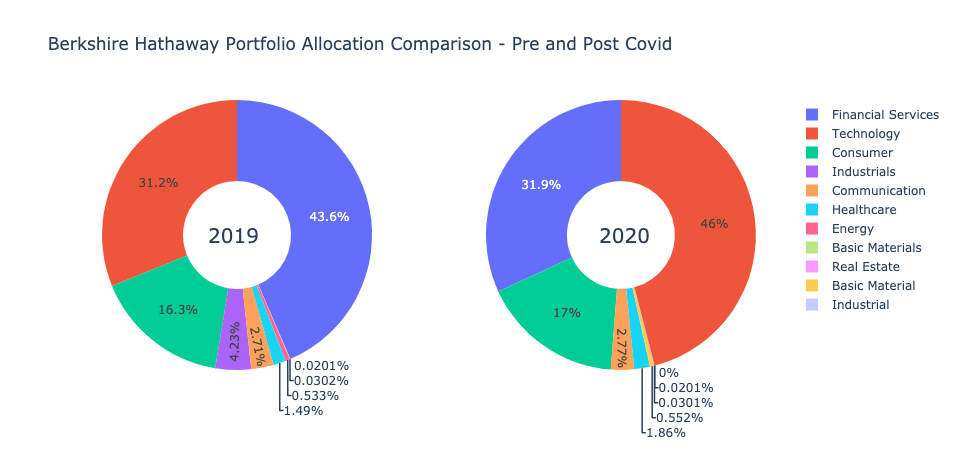

In [33]:
brk_fig = make_subplots(rows=1, cols=2, specs=[[{'type':'domain'}, {'type':'domain'}]])
brk_fig.add_trace(go.Pie(labels=brk_all_19['Industry'], values=brk_all_19['Allocation'], name="2019"),
              1, 1)
brk_fig.add_trace(go.Pie(labels=brk_all_20['Industry'], values=brk_all_20['Allocation'], name="2020"),
              1, 2)


brk_fig.update_traces(hole=.4, hoverinfo="label+percent+name")

brk_fig.update_layout(
    title_text="Berkshire Hathaway Portfolio Allocation Comparison - Pre and Post Covid",
    
    annotations=[dict(text='2019', x=0.18, y=0.5, font_size=20, showarrow=False),
                 dict(text='2020', x=0.82, y=0.5, font_size=20, showarrow=False)])
brk_fig.show()

In [34]:
fig_brk_portfolio = px.line(brk_portfolio)
fig_brk_actual = px.line(brk_actual)
brk = pn.Row(fig_brk_portfolio,fig_brk_actual)

In [35]:
brk_tabs = pn.Tabs(("Portfolio Allocation",brk_fig),("Portfolio Performance",brk))

In [36]:
brk_tabs.servable()

Tabs
    [0] Plotly(Figure, name='Portfolio Allocation')
    [1] Row
        [0] Plotly(Figure)
        [1] Plotly(Figure)